In [1]:
import pandas as pd
import cv2
import os
import matplotlib.pyplot as plt
import shutil
from sklearn.model_selection import train_test_split
import albumentations as A
import random
from PIL import Image

# Преобразование датасета

In [2]:
images_path = r"C:\Users\User\Desktop\rtsd2\rtsd\datasets\data"

In [7]:
# удалим старую аугментацию
train_images = os.path.join(images_path, 'train', 'images')
for file in os.listdir(train_images):
    if file[:3] == 'aug':
        os.remove(os.path.join(train_images, file))

In [12]:
# переместим все изображения в одну папку
data_images = r"C:\Users\User\Desktop\rtsd2\images"

for t in ["train", "test", "val"]:
    folder = os.path.join(images_path, t, 'images')
    for file in os.listdir(folder):
        try:
            shutil.move(os.path.join(folder, file), data_images)
        except:
            continue

In [13]:
# загрузим датасет

data = pd.read_csv(r"C:\Users\User\Desktop\rtsd2\full-gt.csv")
data.head()

,filename,x_from,y_from,width,height,sign_class,sign_id
0,autosave01_02_2012_09_13_33.jpg,649,376,18,18,2_1,0
1,autosave01_02_2012_09_13_34.jpg,671,356,20,21,2_1,0
2,autosave01_02_2012_09_13_35.jpg,711,332,27,26,2_1,0
3,autosave01_02_2012_09_13_36.jpg,764,290,37,36,2_1,0
4,autosave01_02_2012_09_13_36.jpg,684,384,17,17,1_23,1


In [14]:
# удалим столбец sign_id

data = data.drop(columns="sign_id")
data.head()

,filename,x_from,y_from,width,height,sign_class
0,autosave01_02_2012_09_13_33.jpg,649,376,18,18,2_1
1,autosave01_02_2012_09_13_34.jpg,671,356,20,21,2_1
2,autosave01_02_2012_09_13_35.jpg,711,332,27,26,2_1
3,autosave01_02_2012_09_13_36.jpg,764,290,37,36,2_1
4,autosave01_02_2012_09_13_36.jpg,684,384,17,17,1_23


In [15]:
print(f"Объем выборки = {len(data)}")
print(f"Количество класов = {data.sign_class.nunique()}")

Объем выборки = 104358
Количество класов = 198


In [18]:
# pic_box = plt.figure(figsize=(50,50))

# i = 0
# for _, row in data.sample(9).iterrows():
#     img = cv2.imread(os.path.join(data_images, row['filename']))
#     img = cv2.cvtColor(img, cv2.COLOR_RGB2BGR)
#     img = cv2.rectangle(img, (row['x_from'], row['y_from']), (row['x_from'] + row['width'], row['y_from'] + row['height']), (0, 255, 0), 2)
#     pic_box.add_subplot(3, 3, i+1)
#     plt.text(0, 0, row['sign_class'], fontsize=35, color='black')
#     plt.imshow(img)
#     plt.axis('off')
#     i+=1
    
# plt.show()

In [19]:
# соотношение классов
all_cls = data["sign_class"].unique()
d = {}

for cl in all_cls:
    d[cl] = len(data[data["sign_class"] == cl])
    
    
fig, ax = plt.subplots(figsize=(100, 100))

plt.rcParams['font.size'] = '50'

for label in (ax.get_xticklabels() + ax.get_yticklabels()):
    label.set_fontsize(50)
    
ax.bar(range(len(d.keys())), list(d.values()), width=0.8, align='center') 
plt.xlabel('Номер класса', fontsize=90)
plt.ylabel('Количество объектов в классе', fontsize=90)
plt.title("Количество объектов в классах", fontsize=90)

Text(0.5, 1.0, 'Количество объектов в классах')

In [24]:
# посмотрим какого класса больше и меньше всего

count_cls = pd.DataFrame(list(d.items()), columns = ['class', 'count'])
count_cls.sort_values(by = "count", ascending=True)

,class,count
162,3_33,1
82,2_3_5,1
183,3_13_r3.3,1
101,3_13_r2.5,2
60,8_3_3,2
...,...,...
13,2_4,4095
43,5_15_2,4944
8,5_16,5172
0,2_1,10961


Меньше всего:

<img src='https://sun9-17.userapi.com/impg/3HVkYf4vA6i532Az8C1w_1iMWN7ajDvKOA96Mw/bbQ1qUpXv9g.jpg?size=488x502&quality=96&sign=714af24115ccc87f6656b93813cb1636&type=album' width=200>

Больше всего:

<img src='https://sun9-44.userapi.com/impg/_FKTt_WJGou_8WdqrpknmHRqKSy4TSyzMkEpIg/ASUM6TJ9vC4.jpg?size=588x550&quality=96&sign=88166da481cac2d6ad5c9e516028cf5e&type=album' width=200>

In [27]:
# удалим объекты тех классов, у которых объем < 100
cls_for_remove = list(count_cls[count_cls["count"] < 100]["class"])
print(f"Количество класов для удаления = {len(cls_for_remove)}")

Количество класов для удаления = 110


In [32]:
cls_for_remove

['3_25_n20',
 '7_15',
 '3_4_n8',
 '8_3_2',
 '4_1_6',
 '6_7',
 '1_19',
 '8_1_4',
 '8_8',
 '1_27',
 '3_13_r5',
 '8_3_3',
 '1_20',
 '4_8_2',
 '2_3_6',
 '5_22',
 '5_18',
 '2_3_5',
 '8_4_1',
 '3_13_r3.7',
 '3_14_r3.7',
 '7_6',
 '8_1_3',
 '8_2_3',
 '1_31',
 '3_10',
 '3_13_r2.5',
 '7_1',
 '4_1_3',
 '5_4',
 '5_3',
 '3_25_n40',
 '3_13_r4',
 '6_8_2',
 '6_2_n50',
 '3_24_n10',
 '3_25_n50',
 '1_21',
 '1_13',
 '6_2_n70',
 '2_3_4',
 '4_8_3',
 '6_15_2',
 '2_6',
 '1_7',
 '3_19',
 '1_18',
 '2_7',
 '8_5_4',
 '3_25_n80',
 '5_21',
 '3_4_n2',
 '8_6_4',
 '4_5',
 '3_13_r4.2',
 '6_2_n60',
 '3_11_n23',
 '3_11_n9',
 '8_18',
 '8_4_4',
 '3_30',
 '1_5',
 '3_29',
 '6_15_3',
 '5_12',
 '3_16_n3',
 '3_13_r4.3',
 '1_30',
 '5_11',
 '1_6',
 '8_6_2',
 '6_8_3',
 '3_12_n10',
 '3_12_n6',
 '3_33',
 '3_11_n13',
 '3_14_r2.7',
 '3_16_n1',
 '8_4_3',
 '5_8',
 '3_11_n20',
 '3_11_n5',
 '8_14',
 '3_11_n8',
 '3_4_n5',
 '8_17',
 '3_6',
 '3_14_r3',
 '1_26',
 '3_12_n5',
 '8_5_2',
 '6_8_1',
 '5_17',
 '1_10',
 '3_13_r3.5',
 '3_13_r3.3',
 '3

Останется датасет из 88-и классов

In [37]:
data = data[~data["sign_class"].isin(cls_for_remove)]
data["sign_class"].nunique()

88

In [38]:
# распределение оставшихся классов

# соотношение классов
all_cls = data["sign_class"].unique()
d = {}

for cl in all_cls:
    d[cl] = len(data[data["sign_class"] == cl])
    
    
fig, ax = plt.subplots(figsize=(100, 100))

plt.rcParams['font.size'] = '50'

for label in (ax.get_xticklabels() + ax.get_yticklabels()):
    label.set_fontsize(50)
    
ax.bar(range(len(d.keys())), list(d.values()), width=0.8, align='center') 
plt.xlabel('Номер класса', fontsize=90)
plt.ylabel('Количество объектов в классе', fontsize=90)
plt.title("Количество объектов в классах", fontsize=90)

Text(0.5, 1.0, 'Количество объектов в классах')

In [39]:
# сохраним получившийся датасет

data.to_csv(r"C:\Users\User\Desktop\rtsd2\dataset_88.csv", index=False)

In [7]:
data_temp = pd.read_csv(r"C:\Users\User\Desktop\rtsd2\dataset_88.csv")
cls = data_temp["sign_class"].unique()

In [8]:
data_temp.head()

,filename,x_from,y_from,width,height,sign_class
0,autosave01_02_2012_09_13_33.jpg,649,376,18,18,2_1
1,autosave01_02_2012_09_13_34.jpg,671,356,20,21,2_1
2,autosave01_02_2012_09_13_35.jpg,711,332,27,26,2_1
3,autosave01_02_2012_09_13_36.jpg,764,290,37,36,2_1
4,autosave01_02_2012_09_13_36.jpg,684,384,17,17,1_23


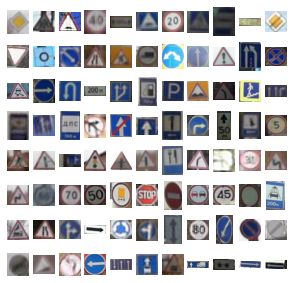

In [31]:
# примеры изображений по классам

pic_box = plt.figure(figsize=(5,5))
i = 0

for c in cls:
    data_c = data_temp[data_temp["sign_class"] == c].sample(1)
    filename = data_c["filename"].to_string().split(" ")[4]
    x_from = int(data_c["x_from"])
    y_from = int(data_c["y_from"])
    width = int(data_c["width"])
    height = int(data_c["height"])
    
    img = cv2.imread(f"C:/Users/User/Desktop/rtsd2/images/{filename}")
    img = img[y_from:y_from+height, x_from:x_from+width]
    img = cv2.cvtColor(img, cv2.COLOR_RGB2BGR)
    
    pic_box.add_subplot(8, 11, i+1)
    plt.imshow(img)
    plt.axis('off')
    i+=1
    
plt.show()
    
    

# Преобразуем изображения для модели

нужно преобразовать изображения к размеру 640х640

In [48]:
def get_new_data(exmpl, images_path, save_image_path): # exmpl - датасет для одного изображения
    img_name = exmpl["filename"].unique()[0]
    img = cv2.imread(os.path.join(images_path, img_name))
    img = cv2.cvtColor(img, cv2.COLOR_RGB2BGR)
    # создание нового датафрейма для разделенного изображения
    data_new = pd.DataFrame(columns=['filename','x_from','y_from','width','height','sign_class'])
    # максимальные и минимальные координаты из всех рамок
    x_max = exmpl["x_from"].max()
    x_min = exmpl["x_from"].min()
    y_max = exmpl["y_from"].max()
    y_min = exmpl["y_from"].min()
    #try:
    y_min_height = int(exmpl[exmpl["y_from"] == y_min]["height"].max())
    #except:
    #    print(exmpl[exmpl["y_from"] == y_min]["height"])
    #    return data_new

    old_h, old_w, _ = img.shape

    if old_w == 1920: # 1920 = 640*3
        num_frames = 3
    else: # иначе 1280 = 640*2
        num_frames = 2

    dist_y = y_max - y_min + y_min_height # максимальное расстояние по y, занимаемое рамками
    if dist_y > 640:
        print("dist_y > 640")
        print(img_name)

    margin = (640 - dist_y) // 2 # отступ от верхней и нижней рамки, для того чтобы получить 640 по y
    if y_max + margin > old_h: # если не хватает места для рамки сверху
        ymx = old_h # верхняя точка нового изображения на старом
        ymn = y_min - y_min_height - margin - (margin - ymx)
    elif y_min - y_min_height - margin < 0: # если не хватает места снизу
        ymn = 0
        ymx = y_max + margin + (margin - y_min + y_min_height)
    else: # если везде хватает
        ymx = y_max + margin
        ymn = y_min - y_min_height - margin
        
    # разбиваем по x исходное изображение на 2 или 3 части, в зависимости от размера
    for i in range(num_frames):
        xmn = 640 * i
        xmx = 640 + xmn
        #plt.imshow(img[ymn : ymx, xmn : xmx])
        # проверяем, попадает ли какая-нибудь из рамок в новом изображении
        for _, row in exmpl.iterrows():
            x_from = row['x_from']
            y_from = row['y_from']
            width = row['width']
            height = row['height']
            filename = row['filename']
            if (x_from >= xmn and x_from + width <= xmx) and (y_from <= ymx and y_from - height >= ymn):
                # то сохраним новое изображение и добавляем данные о нем в новый DF
                img_new = img[ymn : ymx, xmn : xmx]
                filename_new = f"{i}_{filename}"
                img_new_path = os.path.join(save_image_path, filename_new)
                cv2.imwrite(img_new_path, cv2.cvtColor(img_new, cv2.COLOR_RGB2BGR))
                x_from_new = x_from - xmn
                y_from_new = y_from - ymn
                data_new.loc[len(data_new.index)] = [filename_new, x_from_new, y_from_new, width, height, row['sign_class']]
    return data_new
    

In [40]:
unique_imgs = data["filename"].unique()
len(unique_imgs)

58125

Будем подавать на вход функции мини-датасеты для каждого изображения

В итоге получим новую папку с изображениями и новый датасет

In [118]:
data_640 = pd.DataFrame(columns=['filename','x_from','y_from','width','height','sign_class'])
images_640_path = r"C:\Users\User\Desktop\rtsd2\images_640"

In [119]:
for cnt, img_name in enumerate(unique_imgs):
    d_temp = data[data["filename"] == img_name]
    if len(d_temp) != 0:
        data_640 = data_640.append(get_new_data(d_temp, data_images, images_640_path))
    if cnt %  5000 == 0:
        print(cnt)

0
5000
10000
15000
20000
dist_y > 640
autosave13_04_2013_09_47_30_0.jpg
25000
dist_y > 640
autosave13_04_2013_13_17_00_2.jpg
dist_y > 640
autosave13_04_2013_13_18_53_2.jpg
dist_y > 640
autosave13_04_2013_13_21_36_1.jpg
dist_y > 640
autosave13_04_2013_13_24_57_2.jpg
dist_y > 640
autosave13_04_2013_13_45_42_2.jpg
dist_y > 640
autosave13_04_2013_14_16_39_0.jpg
dist_y > 640
autosave13_04_2013_14_16_47_0.jpg
dist_y > 640
autosave13_04_2013_14_16_47_1.jpg
dist_y > 640
autosave13_04_2013_15_16_11_0.jpg
dist_y > 640
autosave13_04_2013_15_16_15_0.jpg
dist_y > 640
autosave13_04_2013_15_17_16_1.jpg
dist_y > 640
autosave13_04_2013_15_17_18_2.jpg
dist_y > 640
autosave13_04_2013_15_23_55_2.jpg
dist_y > 640
autosave13_04_2013_15_34_05_0.jpg
dist_y > 640
autosave13_04_2013_15_48_18_0.jpg
dist_y > 640
autosave13_04_2013_15_53_22_1.jpg
dist_y > 640
autosave13_04_2013_16_01_01_2.jpg
dist_y > 640
autosave16_04_2013_11_41_46_3.jpg
30000
dist_y > 640
autosave16_04_2013_11_56_43_0.jpg
dist_y > 640
autosave16

In [129]:
data_640

,filename,x_from,y_from,width,height,sign_class
0,1_autosave01_02_2012_09_13_33.jpg,9,329,18,18,2_1
0,1_autosave01_02_2012_09_13_34.jpg,31,330,20,21,2_1
0,1_autosave01_02_2012_09_13_35.jpg,71,332,27,26,2_1
0,1_autosave01_02_2012_09_13_36.jpg,124,290,37,36,2_1
1,1_autosave01_02_2012_09_13_36.jpg,44,384,17,17,1_23
...,...,...,...,...,...,...
0,1_autosave24_10_2013_13_18_35_1.jpg,190,323,55,58,2_1
0,1_autosave24_10_2013_13_18_35_2.jpg,317,281,74,78,2_1
0,1_autosave24_10_2013_13_18_38_0.jpg,7,330,33,20,5_15_7
0,1_autosave24_10_2013_13_18_38_1.jpg,28,331,41,23,5_15_7


In [130]:
# сохраним получившийся датасет

data_640.to_csv(r"C:\Users\User\Desktop\rtsd2\dataset_640_88.csv", index=False)

#### Пример работы

Исходное изображение:
C:\Users\User\Desktop\rtsd2\images\autosave16_04_2013_13_02_50_2.jpg


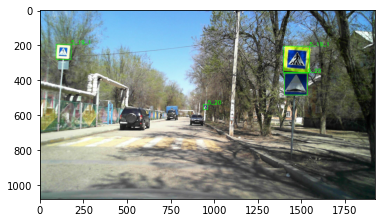

In [93]:
img_name = data_temp.sample(1)["filename"].to_string().split(" ")[4]
#img_name = "autosave16_04_2013_13_12_28_1.jpg"
exmpl = data_temp[data_temp["filename"] == img_name]

print("Исходное изображение:")

print(os.path.join(r"C:\Users\User\Desktop\rtsd2\images", img_name))
img = cv2.imread(os.path.join(r"C:\Users\User\Desktop\rtsd2\images", img_name))
img = cv2.cvtColor(img, cv2.COLOR_RGB2BGR)

for _, row in exmpl.iterrows():
    img = cv2.rectangle(img, (row['x_from'], row['y_from']), (row['x_from'] + row['width'], row['y_from'] + row['height']), (0, 255, 0), 2)
    cv2.putText(img, row['sign_class'], (row['x_from']+row["width"], row['y_from']), cv2.FONT_HERSHEY_SIMPLEX, 1, (0, 255, 0), 2)
plt.imshow(img)

In [94]:
data_new = get_new_data(exmpl, r"C:\Users\User\Desktop\rtsd2\images", r"C:\Users\User\Desktop\t")
data_new

,filename,x_from,y_from,width,height,sign_class
0,0_autosave16_04_2013_13_02_50_2.jpg,92,192,86,87,5_19_1
1,1_autosave16_04_2013_13_02_50_2.jpg,296,535,25,31,5_20
2,2_autosave16_04_2013_13_02_50_2.jpg,115,203,149,154,5_19_1
3,2_autosave16_04_2013_13_02_50_2.jpg,121,354,132,128,5_20


Разделенное изображение:
(640, 640, 3)
(640, 640, 3)
(640, 640, 3)


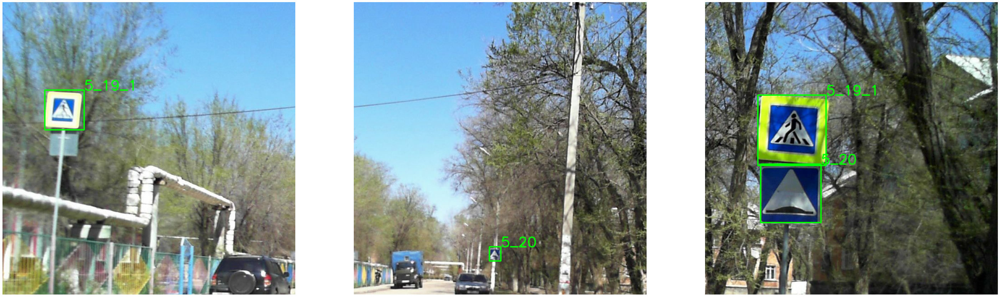

In [95]:
print("Разделенное изображение:")

pic_box = plt.figure(figsize=(50,50))

i = 0
imgs = data_new['filename'].unique()

for img_path in imgs:
    img = os.path.join(r"C:\Users\User\Desktop\t", img_path)
    img = cv2.imread(img)
    img = cv2.cvtColor(img, cv2.COLOR_RGB2BGR)
    print(img.shape)
    for _, row in data_new[data_new['filename'] == img_path].iterrows():
        img = cv2.rectangle(img, (row['x_from'], row['y_from']), (row['x_from'] + row['width'], row['y_from'] + row['height']), (0, 255, 0), 2)
        cv2.putText(img, row['sign_class'], (row['x_from']+row["width"], row['y_from']), cv2.FONT_HERSHEY_SIMPLEX, 1, (0, 255, 0), 2)
    pic_box.add_subplot(1, 3, i+1)
    plt.imshow(img)
    plt.axis('off')
    i+=1
    
plt.show()

# Получившийся датасет

In [131]:
# соотношение классов
all_cls = data_640["sign_class"].unique()
d = {}

for cl in all_cls:
    d[cl] = len(data_640[data_640["sign_class"] == cl])
    
    
fig, ax = plt.subplots(figsize=(100, 100))

plt.rcParams['font.size'] = '50'

for label in (ax.get_xticklabels() + ax.get_yticklabels()):
    label.set_fontsize(50)
    
ax.bar(range(len(d.keys())), list(d.values()), width=0.8, align='center') 
plt.xlabel('Номер класса', fontsize=90)
plt.ylabel('Количество объектов в классе', fontsize=90)
plt.title("Количество объектов в классах", fontsize=90)

Text(0.5, 1.0, 'Количество объектов в классах')

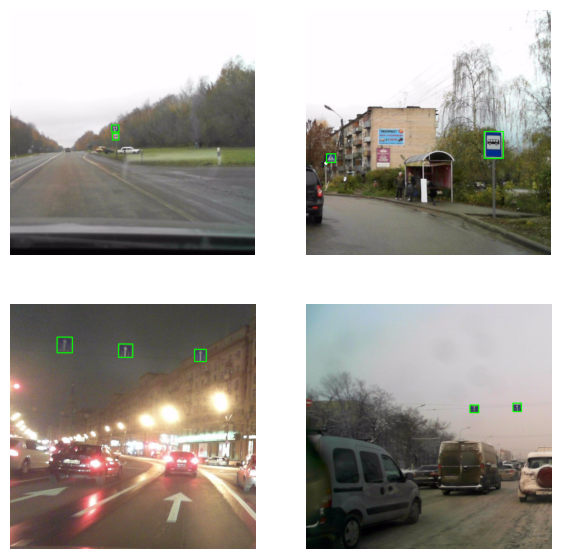

In [139]:
pic_box = plt.figure(figsize=(7,7))

i = 0
for _, row in data_640.sample(4).iterrows():
    filename = row["filename"]
    img = cv2.imread(os.path.join(images_640_path, filename))
    img = cv2.cvtColor(img, cv2.COLOR_RGB2BGR)
    for _, row1 in data_640[data_640["filename"] == filename].iterrows():
        img = cv2.rectangle(img, (row1['x_from'], row1['y_from']), (row1['x_from'] + row1['width'], row1['y_from'] + row1['height']), (0, 255, 0), 2)
    pic_box.add_subplot(2, 2, i+1)
        #plt.text(0, 0, row1['sign_class'], fontsize=35, color='black')
    plt.imshow(img)
    plt.axis('off')
    i+=1
    
plt.show()

# Разделение данных

Разделим данные на train и test в соотношении 80 на 20

In [141]:
train, test = train_test_split(data_640, test_size=0.2)

In [142]:
print(f"Размер тренировочной выборки = {len(train)}")
print(f"Размер тестовой выборки = {len(test)}")

Размер тренировочной выборки = 76100
Размер тестовой выборки = 19026


In [144]:
# сохраним датасеты

train.to_csv(r"C:\Users\User\Desktop\rtsd2\train_dataset_640_88.csv", index=False)
test.to_csv(r"C:\Users\User\Desktop\rtsd2\test_dataset_640_88.csv", index=False)

# Аугментация

Text(0.5, 1.0, 'Количество объектов в классах')

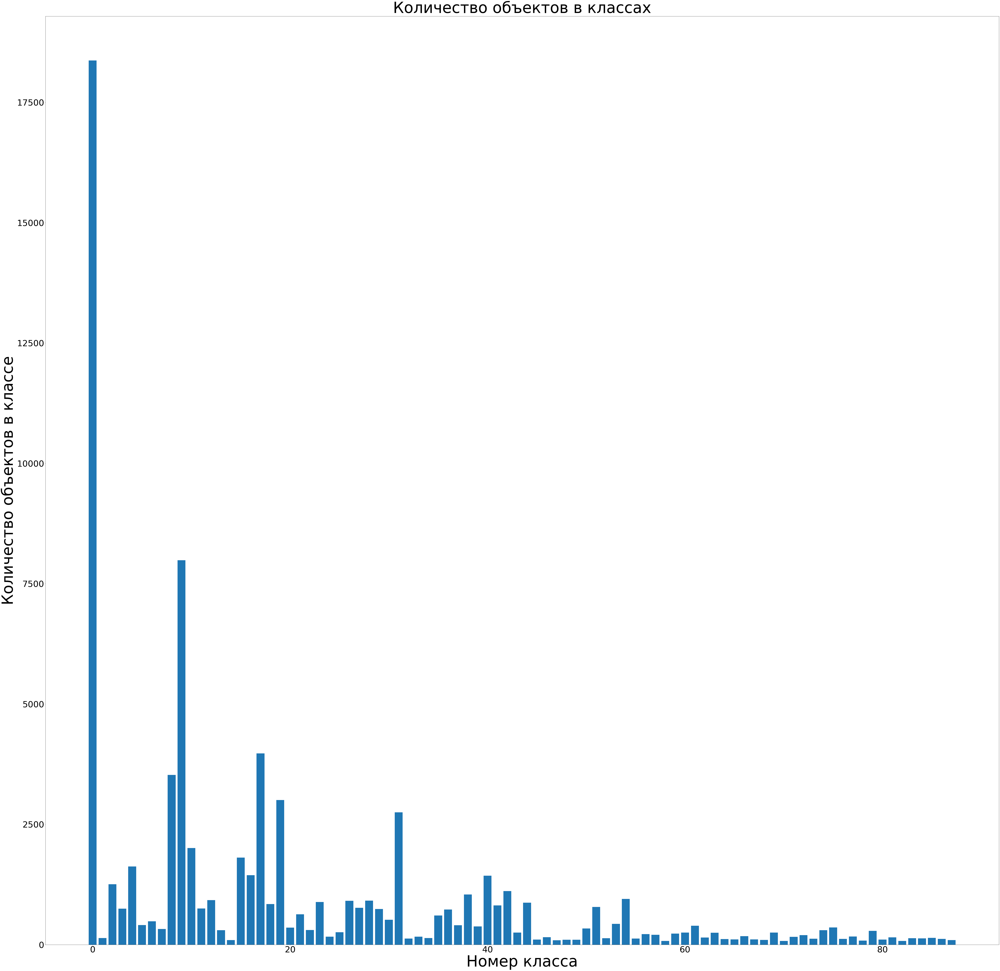

In [3]:
# соотношение классов
all_cls = train["sign_class"].unique()
d = {}

for cl in all_cls:
    d[cl] = len(train[train["sign_class"] == cl])
    
    
fig, ax = plt.subplots(figsize=(100, 100))

plt.rcParams['font.size'] = '50'

for label in (ax.get_xticklabels() + ax.get_yticklabels()):
    label.set_fontsize(50)
    
ax.bar(range(len(d.keys())), list(d.values()), width=0.8, align='center') 
plt.xlabel('Номер класса', fontsize=90)
plt.ylabel('Количество объектов в классе', fontsize=90)
plt.title("Количество объектов в классах", fontsize=90)

Расширим в тренировочном наборе объем классов до 1000 элементов

In [102]:
transform = A.Compose([
        A.Rotate(limit=20, p=1), # поворот
        A.OneOf([
            A.Downscale(scale_min=0.6, scale_max=0.8, p=0.5), # понижение качества
            A.GaussNoise(var_limit=(200.0, 500.0), mean=0, p=0.3), # гауссов шум
        ], p = 0.9),
        A.RandomContrast (limit=0.3, p=0.7), # контраст
        A.OneOf([
            A.RandomFog(fog_coef_lower=0.05, fog_coef_upper=0.2, alpha_coef=0.1, p=0.5), # туман
            A.RandomRain(slant_lower=-10, slant_upper=10, drop_length=20, drop_width=1, blur_value=2, brightness_coefficient=1., p=0.5), # дождь
            A.Blur(blur_limit=2, p=0.3), #размытие
        ], p=0.6),
        A.Sharpen (alpha=(0.2, 0.5), lightness=(0.5, 1.0), always_apply=False, p=0.8), # резкость
    ],
    bbox_params=A.BboxParams(format='coco', min_visibility=0.5, label_fields=['category_ids']),
)
random.seed(42)

C:\Users\User\AppData\Roaming\Python\Python39\site-packages\albumentations\augmentations\transforms.py:1554: UserWarning: Using default interpolation INTER_NEAREST, which is sub-optimal.Please specify interpolation mode for downscale and upscale explicitly.For additional information see this PR https://github.com/albumentations-team/albumentations/pull/584
  warnings.warn(
C:\Users\User\AppData\Roaming\Python\Python39\site-packages\albumentations\augmentations\transforms.py:1175: FutureWarning: RandomContrast has been deprecated. Please use RandomBrightnessContrast
  warnings.warn(


In [101]:
all_classes = train["sign_class"].unique()
image_640_path = r"C:\Users\User\Desktop\rtsd2\images_640"
data_640_aug = pd.DataFrame(columns=['filename','x_from','y_from','width','height','sign_class'])
total_cnt = 1000
save_path = r"C:\Users\User\Desktop\rtsd2\images_640"

In [55]:
all_classes

array(['5_19_1', '3_2', '5_15_3', '3_1', '3_24_n40', '2_5', '2_3_3',
       '5_15_7', '5_15_2', '2_1', '1_23', '5_5', '4_2_3', '3_21',
       '3_24_n80', '4_1_1', '3_20', '5_16', '6_4', '2_4', '4_1_2', '6_6',
       '1_11', '4_1_4', '4_1_2_1', '3_28', '1_17', '8_2_1', '4_2_1',
       '2_3_2', '8_13', '3_27', '3_13_r4.5', '1_1', '1_12_2', '3_24_n20',
       '1_22', '5_6', '5_15_2_2', '4_2_2', '5_20', '6_16', '5_15_1',
       '7_5', '7_3', '8_13_1', '1_12', '8_2_4', '3_24_n30', '4_1_2_2',
       '2_3', '1_25', '8_3_1', '3_4_1', '5_15_5', '4_3', '3_24_n50',
       '6_3_1', '1_20_3', '1_2', '1_16', '2_2', '3_31', '5_14', '7_12',
       '7_4', '3_24_n5', '5_7_2', '1_33', '8_15', '3_24_n60', '8_1_1',
       '3_18', '6_15_1', '1_20_2', '1_11_1', '7_7', '1_15', '3_32', '1_8',
       '5_7_1', '4_1_5', '1_14', '3_18_2', '7_2', '3_24_n70', '7_11',
       '8_2_2'], dtype=object)

In [102]:
for cls in all_classes: #перебираем классы
    data_cls = train[train["sign_class"] == cls]
    l = len(data_cls)
    i = 0 # количество сгенерированных объектов
    if l < total_cnt: # если не хватает объектов
        gen_cnt = total_cnt - l # сколько нужно сгенерировать
        while True:
            try:
                row = data_cls.sample(1).iloc[0, :] # рандомно выбираем изображение (объект) для аугментации
                filename = row["filename"]
                img = cv2.imread(os.path.join(image_640_path, filename))
                #делаем аугментацию
                bboxes = [[row['x_from'], row['y_from'], row['width'], row['height']]]
                transformed = transform(image=img, bboxes=bboxes, category_ids=[0])
                img_name_aug = f"aug_({cls})_{i}_{filename}"
                image_aug = transformed['image'] # сгенерированная картинка
                
                x_min, y_min, w, h = transformed['bboxes'][0] # координаты рамки

                # добавим данные о новой картинке в csv
                data_640_aug.loc[len(data_640_aug.index)] = [img_name_aug, int(x_min), int(y_min), int(w), int(h), cls]

                # сохраним картинку
                p = os.path.join(save_path, img_name_aug)
                cv2.imwrite(p, image_aug)

                i += 1

                if (i >= gen_cnt):
                    break
            except:
                continue

In [103]:
data_640_aug.to_csv(r"C:\Users\User\Desktop\rtsd2\data_640_aug.csv", index=False)

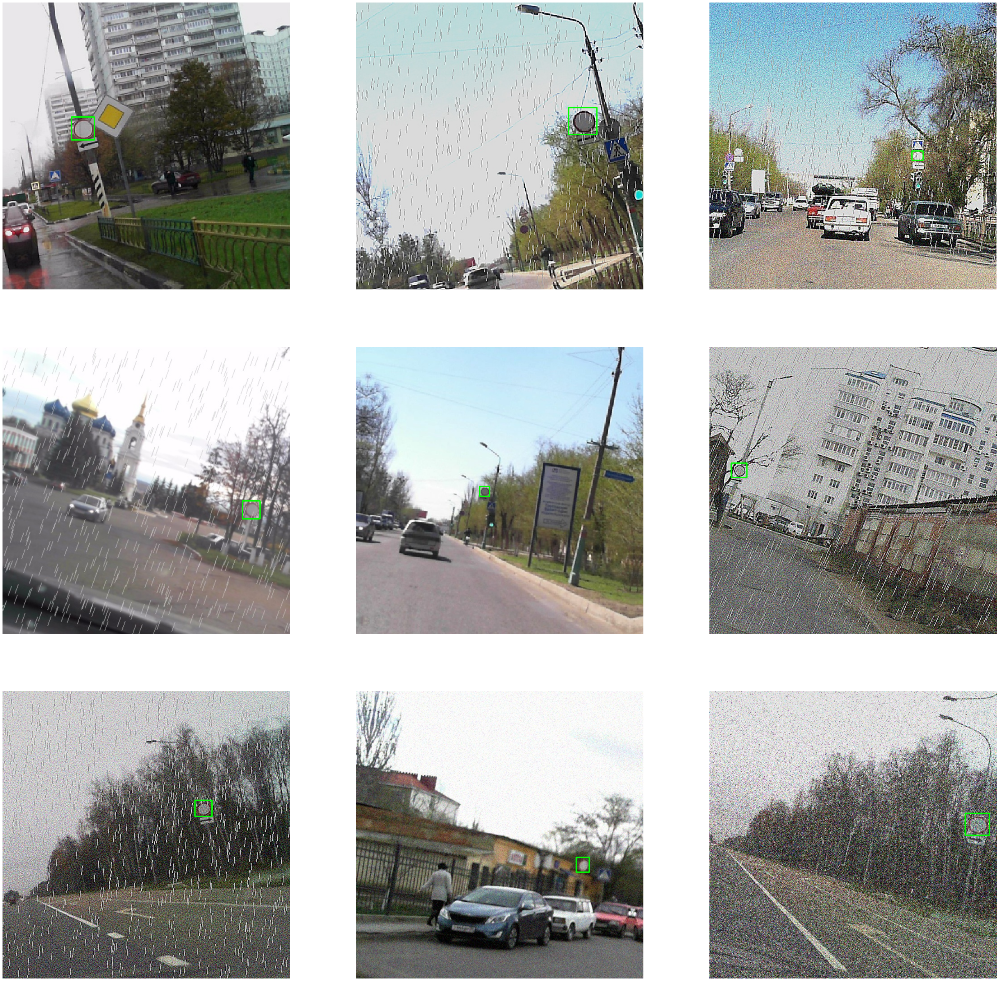

In [64]:
#пример аугментированных изображений

pic_box = plt.figure(figsize=(50,50))

i = 0
for _, row in data_640_aug.sample(9).iterrows():
    filename = row["filename"]
    img = cv2.imread(os.path.join(save_path, filename))
    img = cv2.cvtColor(img, cv2.COLOR_RGB2BGR)
    for _, row1 in data_640_aug[data_640_aug["filename"] == filename].iterrows():
        img = cv2.rectangle(img, (row1['x_from'], row1['y_from']), (row1['x_from'] + row1['width'], row1['y_from'] + row1['height']), (0, 255, 0), 2)
    pic_box.add_subplot(3, 3, i+1)
    plt.imshow(img)
    plt.axis('off')
    i+=1
    
plt.show()

In [104]:
data_640_aug

,filename,x_from,y_from,width,height,sign_class
0,aug_(3_2)_0_1_autosave16_04_2013_12_32_38_2.jpg,403,314,36,36,3_2
1,aug_(3_2)_1_1_autosave10_10_2012_09_26_10_2.jpg,271,365,22,24,3_2
2,aug_(3_2)_2_1_autosave09_10_2012_12_37_52_1.jpg,526,296,47,44,3_2
3,aug_(3_2)_3_0_autosave23_10_2012_15_24_00_2.jpg,534,317,31,33,3_2
4,aug_(3_2)_4_1_autosave21_01_2013_09_36_34_2.jpg,347,287,40,35,3_2
...,...,...,...,...,...,...
49242,aug_(8_2_2)_900_1_autosave09_10_2012_08_13_02_...,271,237,23,36,8_2_2
49243,aug_(8_2_2)_901_1_autosave09_10_2012_08_36_02_...,423,350,36,51,8_2_2
49244,aug_(8_2_2)_902_1_autosave09_10_2012_08_13_04_...,465,204,37,53,8_2_2
49245,aug_(8_2_2)_903_0_autosave24_10_2012_10_10_43_...,380,350,30,40,8_2_2


In [109]:
# соберем новый тренировочный датасет 
train_aug = train.append(data_640_aug)
train_aug.to_csv(r"C:\Users\User\Desktop\rtsd2\train_aug.csv", index=False)

C:\Users\User\AppData\Local\Temp\ipykernel_3064\4155193925.py:2: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train_aug = train.append(data_640_aug)


Text(0.5, 1.0, 'Количество объектов в классах')

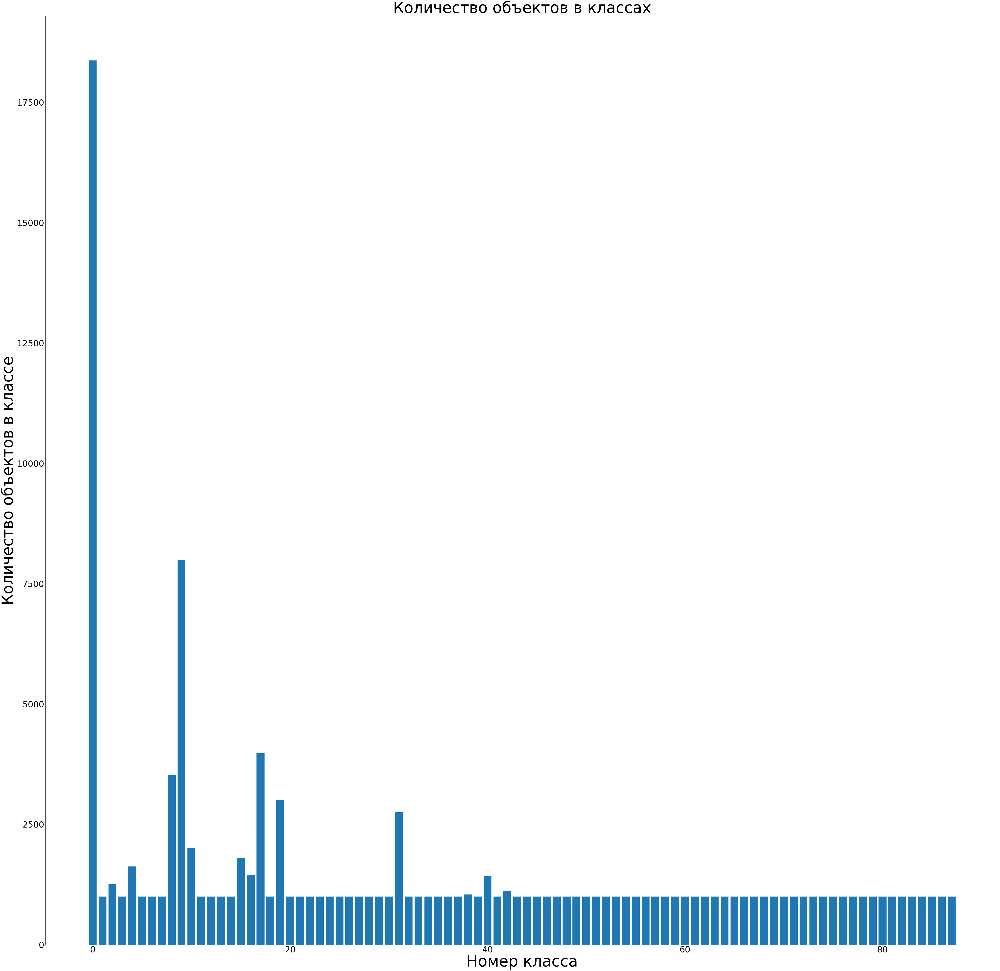

In [108]:
# соотношение классов
all_cls = train_aug["sign_class"].unique()
d = {}

for cl in all_cls:
    d[cl] = len(train_aug[train_aug["sign_class"] == cl])
    
    
fig, ax = plt.subplots(figsize=(100, 100))

plt.rcParams['font.size'] = '50'

for label in (ax.get_xticklabels() + ax.get_yticklabels()):
    label.set_fontsize(50)
    
ax.bar(range(len(d.keys())), list(d.values()), width=0.8, align='center') 
plt.xlabel('Номер класса', fontsize=90)
plt.ylabel('Количество объектов в классе', fontsize=90)
plt.title("Количество объектов в классах", fontsize=90)

# Подготовка датасета для перевода в TFRecord

In [115]:
def create_tfrecord_csv(data_csv, images_path):
    data = pd.DataFrame(columns=['filename', 'width', 'height', 'class', 'xmin', 'ymin', 'xmax', 'ymax'])
    for _, row in data_csv.iterrows():
        filename = row["filename"]
        try:
            im = Image.open(os.path.join(images_path, filename))
            (width, height) = im.size
            cls = row["sign_class"]
            xmin = row["x_from"]
            ymin = row["y_from"]
            xmax = xmin + row["width"]
            ymax = ymin + row["height"]
            if xmax > width:
                xmax = width
            if ymax > height:
                ymax = height
            data.loc[len(data.index)] = [filename, width, height, cls, xmin, ymin, xmax, ymax]
        except FileNotFoundError:
            continue
    return data

In [123]:
train_tfrecord

,filename,width,height,class,xmin,ymin,xmax,ymax
0,0_autosave09_10_2012_13_49_59_3.jpg,640,640,5_19_1,573,337,598,361
1,0_autosave13_04_2013_12_15_01_1.jpg,640,640,5_19_1,266,366,302,400
2,1_autosave21_01_2013_13_38_56_1.jpg,640,639,3_2,337,293,384,340
3,1_autosave02_10_2012_12_10_07_2.jpg,640,639,5_15_3,206,210,230,237
4,0_autosave02_10_2012_12_02_29_2.jpg,640,640,3_1,610,229,632,254
...,...,...,...,...,...,...,...,...
125298,aug_(8_2_2)_900_1_autosave09_10_2012_08_13_02_...,640,640,8_2_2,271,237,294,273
125299,aug_(8_2_2)_901_1_autosave09_10_2012_08_36_02_...,640,639,8_2_2,423,350,459,401
125300,aug_(8_2_2)_902_1_autosave09_10_2012_08_13_04_...,640,639,8_2_2,465,204,502,257
125301,aug_(8_2_2)_903_0_autosave24_10_2012_10_10_43_...,640,639,8_2_2,380,350,410,390


In [116]:
train_tfrecord = create_tfrecord_csv(train_aug, r"C:\Users\User\Desktop\rtsd2\images_640")
train_tfrecord.to_csv(r"C:\Users\User\Desktop\rtsd2\train_tfrecord.csv", index=False)

In [126]:
test_tfrecord = create_tfrecord_csv(test, r"C:\Users\User\Desktop\rtsd2\images_640")
test_tfrecord.to_csv(r"C:\Users\User\Desktop\rtsd2\test_tfrecord.csv", index=False)

label_map.pbtxt

<img src='https://sun9-8.userapi.com/impg/1cbV2Iht4W6WfBR2J-5usZdmP1n6et5bt2cV2w/sdRMmHM3elo.jpg?size=525x515&quality=96&sign=faaaf792b20832583a3833cb2149f3bd&type=album' width=320, heigth=240>

далее будем подавать созданные csv на вход конвертору tfrecord (generate_tfrecord.py)

In [3]:
t = pd.read_csv(r"C:\Users\User\Desktop\rtsd2\train_aug.csv")

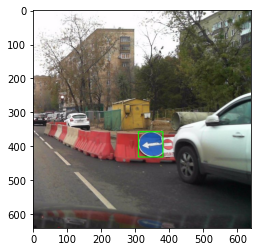

In [26]:
row = t[t["sign_class"]=='4_1_2_2'].iloc[10, :]
img = cv2.imread(os.path.join(r"C:\Users\User\Desktop\rtsd2\images_640", row["filename"]))
img = cv2.cvtColor(img, cv2.COLOR_RGB2BGR)
img = cv2.rectangle(img, (row['x_from'], row['y_from']), (row['x_from'] + row['width'], row['y_from'] + row['height']), (0, 255, 0), 2)
plt.imshow(img)

In [34]:
sorted(t["sign_class"].unique())

['1_1',
 '1_11',
 '1_11_1',
 '1_12',
 '1_12_2',
 '1_14',
 '1_15',
 '1_16',
 '1_17',
 '1_2',
 '1_20_2',
 '1_20_3',
 '1_22',
 '1_23',
 '1_25',
 '1_33',
 '1_8',
 '2_1',
 '2_2',
 '2_3',
 '2_3_2',
 '2_3_3',
 '2_4',
 '2_5',
 '3_1',
 '3_13_r4.5',
 '3_18',
 '3_18_2',
 '3_2',
 '3_20',
 '3_21',
 '3_24_n20',
 '3_24_n30',
 '3_24_n40',
 '3_24_n5',
 '3_24_n50',
 '3_24_n60',
 '3_24_n70',
 '3_24_n80',
 '3_27',
 '3_28',
 '3_31',
 '3_32',
 '3_4_1',
 '4_1_1',
 '4_1_2',
 '4_1_2_1',
 '4_1_2_2',
 '4_1_4',
 '4_1_5',
 '4_2_1',
 '4_2_2',
 '4_2_3',
 '4_3',
 '5_14',
 '5_15_1',
 '5_15_2',
 '5_15_2_2',
 '5_15_3',
 '5_15_5',
 '5_15_7',
 '5_16',
 '5_19_1',
 '5_20',
 '5_5',
 '5_6',
 '5_7_1',
 '5_7_2',
 '6_15_1',
 '6_16',
 '6_3_1',
 '6_4',
 '6_6',
 '7_11',
 '7_12',
 '7_2',
 '7_3',
 '7_4',
 '7_5',
 '7_7',
 '8_13',
 '8_13_1',
 '8_15',
 '8_1_1',
 '8_2_1',
 '8_2_2',
 '8_2_4',
 '8_3_1']